# **U-Net Instance Segmentation : Binary**
## Detecting roads in car driving clips
## Dataset: CamVid

# IMPORTS
a lot ik :)

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import albumentations as A
from albumentations.pytorch import ToTensorV2
from albumentations.pytorch.functional import img_to_tensor
import cv2 as cv
from PIL import Image
from tqdm.notebook import tqdm
from pathlib import Path
from dataclasses import dataclass
import pytorch_lightning as pl
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
import torchmetrics

# Creating a dataclass to load data easily

In [2]:
@dataclass
class DataFrame:
    train_images = list(Path('/kaggle/input/camvid/CamVid/train').glob('*'))
    train_labels = list(Path('/kaggle/input/camvid/CamVid/train_labels').glob('*'))
    train_images.sort();train_labels.sort();
    
    classes = pd.read_csv('/kaggle/input/camvid/CamVid/class_dict.csv')
    labels = dict(zip(range(len(classes)), classes['name'].tolist()))
    color_map = dict(zip(range(len(classes)),classes.iloc[:,1:].values.tolist()))
    
    assert len(train_images) == len(train_labels)
    
    train_set = list(zip(train_images,train_labels))
    
    val_images = list(Path('/kaggle/input/camvid/CamVid/val').glob('*'))
    val_labels = list(Path('/kaggle/input/camvid/CamVid/val_labels').glob('*'))
    val_images.sort();val_labels.sort();
    
    assert len(val_images) == len(val_labels)
    
    val_set = list(zip(val_images,val_labels))
    
    test_images = list(Path('/kaggle/input/camvid/CamVid/test').glob('*'))
    test_labels = list(Path('/kaggle/input/camvid/CamVid/test_labels').glob('*'))
    test_images.sort();test_labels.sort();
    
    assert len(test_images) == len(test_labels)
    
    test_set = list(zip(test_images,test_labels))

In [3]:
df = DataFrame()
len(df.train_set), len(df.val_set), len(df.test_set)

(369, 100, 232)

In [4]:
df.labels

{0: 'Animal',
 1: 'Archway',
 2: 'Bicyclist',
 3: 'Bridge',
 4: 'Building',
 5: 'Car',
 6: 'CartLuggagePram',
 7: 'Child',
 8: 'Column_Pole',
 9: 'Fence',
 10: 'LaneMkgsDriv',
 11: 'LaneMkgsNonDriv',
 12: 'Misc_Text',
 13: 'MotorcycleScooter',
 14: 'OtherMoving',
 15: 'ParkingBlock',
 16: 'Pedestrian',
 17: 'Road',
 18: 'RoadShoulder',
 19: 'Sidewalk',
 20: 'SignSymbol',
 21: 'Sky',
 22: 'SUVPickupTruck',
 23: 'TrafficCone',
 24: 'TrafficLight',
 25: 'Train',
 26: 'Tree',
 27: 'Truck_Bus',
 28: 'Tunnel',
 29: 'VegetationMisc',
 30: 'Void',
 31: 'Wall'}

In [5]:
list(zip(df.color_map.values(),df.labels.values()))

[([64, 128, 64], 'Animal'),
 ([192, 0, 128], 'Archway'),
 ([0, 128, 192], 'Bicyclist'),
 ([0, 128, 64], 'Bridge'),
 ([128, 0, 0], 'Building'),
 ([64, 0, 128], 'Car'),
 ([64, 0, 192], 'CartLuggagePram'),
 ([192, 128, 64], 'Child'),
 ([192, 192, 128], 'Column_Pole'),
 ([64, 64, 128], 'Fence'),
 ([128, 0, 192], 'LaneMkgsDriv'),
 ([192, 0, 64], 'LaneMkgsNonDriv'),
 ([128, 128, 64], 'Misc_Text'),
 ([192, 0, 192], 'MotorcycleScooter'),
 ([128, 64, 64], 'OtherMoving'),
 ([64, 192, 128], 'ParkingBlock'),
 ([64, 64, 0], 'Pedestrian'),
 ([128, 64, 128], 'Road'),
 ([128, 128, 192], 'RoadShoulder'),
 ([0, 0, 192], 'Sidewalk'),
 ([192, 128, 128], 'SignSymbol'),
 ([128, 128, 128], 'Sky'),
 ([64, 128, 192], 'SUVPickupTruck'),
 ([0, 0, 64], 'TrafficCone'),
 ([0, 64, 64], 'TrafficLight'),
 ([192, 64, 128], 'Train'),
 ([128, 128, 0], 'Tree'),
 ([192, 128, 192], 'Truck_Bus'),
 ([64, 0, 64], 'Tunnel'),
 ([192, 192, 0], 'VegetationMisc'),
 ([0, 0, 0], 'Void'),
 ([64, 192, 0], 'Wall')]

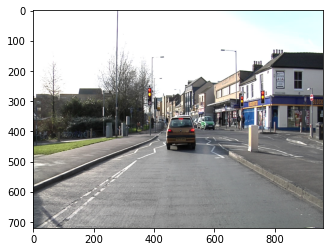

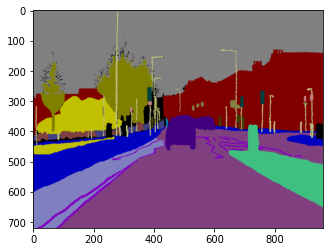

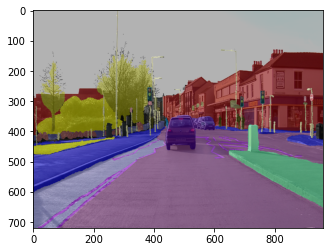

In [6]:
img,mask = df.train_set[100]
plt.imshow(Image.open(img))
plt.show()
plt.imshow(Image.open(mask))
plt.show()
plt.imshow(Image.open(img))
plt.imshow(Image.open(mask),alpha=0.6)
plt.show()

# Animation to visualize the dataset segmentation map

In [7]:
from matplotlib import animation, rc
rc('animation', html='jshtml')

def create_anim(save=True):
    fig, [ax1,ax2] = plt.subplots(1,2,dpi=150)
    ax1.axis('off')
    ax2.axis('off')
    images = []
    for i in tqdm(range(100)):
        im1,im2 = df.train_set[i]
        sample = Image.open(im1).convert('RGB')
        mask = Image.open(im2).convert('RGB')
        im1 = ax1.imshow(sample, animated=True)
        im2 = ax2.imshow(mask, animated=True)
        if i==0:
            ax1.imshow(sample)
            ax2.imshow(mask)
        images.append([im1,im2])


    ani = animation.ArtistAnimation(fig, images, interval=100, blit=True,
                                    repeat_delay=1000)
    plt.close()
    
    if save:
        writer = animation.PillowWriter(fps=10)
        ani.save('train_sample.gif',writer=writer,savefig_kwargs={'facecolor':'white'})
    
    return ani

# create_anim(save=True)

# Creating the dataset

- using albumentations to do all the transforms on image and segmentation map
- images read using open-cv, handled using numpy
- the RGB segmentation map is then isolated to a 32 individual binary masks for each class, 17 is road for example [took forever to figure it out :/]
- converted to torch tensors, rest is simple

In [8]:
class CamVidDataset:
    def __init__(self, split, cmap, labels, val=False, single=None):
        self.split = split
        self.cmap = cmap
        self.labels = {y:x for x,y in labels.items()}
        self.tfms = A.Compose([
            A.CLAHE(),
            A.Resize(180,180),
            A.HorizontalFlip(),
            A.RandomBrightnessContrast(),
            A.GaussianBlur(blur_limit=(1,5))
        ])
        self.val_tfms = A.Compose([
            A.Resize(180,180)
        ])
        self.val = val
        self.single = self.labels[single] if single is not None else None
        
        
    def __len__(self):
        return len(self.split)
    
    def __getitem__(self,idx):
        
        sample,seg = self.split[idx]
        
        sample = cv.imread(str(sample))
        sample = cv.cvtColor(sample,cv.COLOR_BGR2RGB)
        
        seg = cv.imread(str(seg))
        seg = cv.cvtColor(seg,cv.COLOR_BGR2RGB)
        
        if self.val:
            aug = self.val_tfms(image=sample,mask=seg)
        else:
            aug = self.tfms(image=sample,mask=seg)
            
        sample,seg = aug['image'],aug['mask']
        
        mask_shape = *seg.shape[:2],len(self.cmap)
        mask = np.zeros(mask_shape)
        
        for i,color in self.cmap.items():
            mask[:,:,i] = np.all(np.equal(seg,color),axis=-1)
            
            
        if self.single is not None:
            mask = mask[:,:,self.single]
            mask = torch.tensor(mask,dtype=torch.float32).unsqueeze(2).permute(2,0,1)
        else:
            mask = torch.tensor(mask,dtype=torch.float32).permute(2,0,1)
            
        sample = img_to_tensor(sample)
    
        return sample,mask

# DataLoaders

In [9]:
train_ds = CamVidDataset(df.train_set,df.color_map,df.labels,single='Road')
val_ds = CamVidDataset(df.val_set, df.color_map,df.labels,single='Road',val=True)
test_ds = CamVidDataset(df.test_set, df.color_map,df.labels,single='Road',val=True)

output_ds = CamVidDataset(df.test_set[100:201],df.color_map,df.labels,single='Road',val=True)

In [10]:
train_ds[0][0].shape

torch.Size([3, 180, 180])

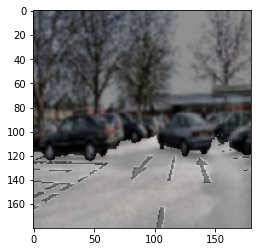

In [11]:
plt.imshow(train_ds[50][0].permute(1,2,0))
plt.imshow(train_ds[50][1].permute(1,2,0),alpha=0.4,cmap='gray') # road
plt.show()

In [12]:
train_loader = torch.utils.data.DataLoader(train_ds, shuffle=True, batch_size=8)
valid_loader = torch.utils.data.DataLoader(val_ds, shuffle=False, batch_size=8)

output_loader = torch.utils.data.DataLoader(output_ds, shuffle=False, batch_size=16)

# Preparing the Model

- using @aladdinpersson's UNET model for now. It's vanilla with batchnorm added

In [13]:
!git clone https://github.com/aladdinpersson/Machine-Learning-Collection.git

Cloning into 'Machine-Learning-Collection'...
remote: Enumerating objects: 1100, done.
remote: Counting objects: 100% (61/61), done.
remote: Compressing objects: 100% (35/35), done.
remote: Total 1100 (delta 22), reused 55 (delta 18), pack-reused 1039
Receiving objects: 100% (1100/1100), 96.07 MiB | 23.82 MiB/s, done.
Resolving deltas: 100% (437/437), done.


In [14]:
import sys
sys.path.append('/kaggle/working/Machine-Learning-Collection/ML/Pytorch/image_segmentation/semantic_segmentation_unet')
from model import UNET

# PyTorch Lightning for Training

- not really my first choice anymore but I don't like writing scripts anymore. Should've used fast.ai but this gives more _from scratch_ vibes.

In [15]:
class BinaryUNetModel(pl.LightningModule):
    
    def __init__(self, pretrained=True, in_channels = 3, num_classes = 1, lr=3e-4):
        super(BinaryUNetModel, self).__init__()
        self.in_channels = in_channels
        self.num_classes = num_classes
        self.lr = lr
        
        self.model = UNET(self.in_channels, self.num_classes)
        
        self.loss_fn = nn.BCEWithLogitsLoss()
        
        self.train_acc = torchmetrics.Accuracy(task='binary')
        self.val_acc = torchmetrics.Accuracy(task='binary')
        
        self.outputs = []
        
        
    def forward(self, x):
        return self.model(x)
    
    
    def configure_optimizers(self):
        optimizer = torch.optim.AdamW(self.model.parameters(), lr=self.lr)
        return optimizer
    
    
    def training_step(self, batch, batch_idx):
        
        x, y = batch
        
        preds = self.model(x)
        
        loss = self.loss_fn(preds, y)
        self.train_acc(preds, y)
        
        self.log('train_loss', loss.item(), on_epoch=True)
        self.log('train_acc', self.train_acc, on_epoch=True)
        
        return loss
    
    
    def validation_step(self, batch, batch_idx):
        
        x,y = batch
        
        preds = self.model(x)
        
        loss = self.loss_fn(preds, y)
        self.val_acc(preds,y)
        
        self.log('val_loss', loss.item(), on_epoch=True)
        self.log('val_acc', self.val_acc, on_epoch=True)
        
    
    def test_step(self, batch, batch_idx):
        
        x,y = batch
        preds = self.model(x)
        
        self.outputs.append(preds.detach().cpu())

# Training

In [16]:
model = BinaryUNetModel()
trainer = pl.Trainer(accelerator='gpu', 
                     max_epochs=5,
                     callbacks=[
                         EarlyStopping(monitor="val_loss", 
                                       mode="min",
                                       patience=1,
                                      )
                         ],
                     log_every_n_steps=25
                    )

In [17]:
trainer.fit(model, train_loader, valid_loader)

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [18]:
trainer.logged_metrics

{'train_loss_step': tensor(0.1568),
 'train_acc_step': tensor(0.9454),
 'val_loss': tensor(0.1285),
 'val_acc': tensor(0.9599),
 'train_loss_epoch': tensor(0.1529),
 'train_acc_epoch': tensor(0.9523)}

# Train sample prediction comparison

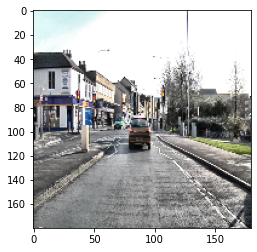

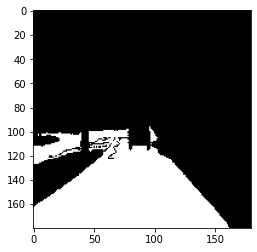

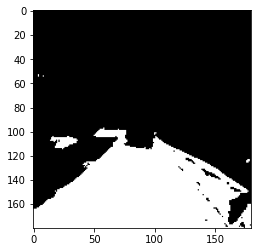

In [19]:
x,y = train_ds[100]
y_pred = model(x.unsqueeze(0)).squeeze(0)
plt.imshow(x.permute(1,2,0))
plt.show()
plt.imshow(y.permute(1,2,0),cmap='gray')
plt.show()
plt.imshow((torch.sigmoid(y_pred.permute(1,2,0)) > 0.5).detach().cpu().numpy(),cmap='gray')
plt.show()

# Using test dataset to predict roads

In [20]:
trainer.test(model,output_loader)

Testing: 0it [00:00, ?it/s]

[{}]

In [21]:
outputs = model.outputs
outputs = torch.sigmoid(torch.vstack(outputs)) > 0.5
print('torch',outputs.shape)
outputs = outputs.permute(0,2,3,1).numpy()
print('numpy',outputs.shape)

torch torch.Size([101, 1, 180, 180])
numpy (101, 180, 180, 1)


In [22]:
img_outputs = []
for i in range(outputs.shape[0]):
    img_outputs.append(outputs[i,:,:,:])

In [23]:
original_images = []
for i in range(100,201):
    img = cv.imread(str(df.test_images[i]))
    img = cv.cvtColor(img,cv.COLOR_BGR2RGB)
    img = cv.resize(img,(180,180))
    img = np.array(img)
    original_images.append(img)

In [24]:
len(original_images)

101

In [25]:
original_images[0].dtype, img_outputs[0].dtype

(dtype('uint8'), dtype('bool'))

# Test dataset Animation

In [26]:
def create_out_anim(save=True):
    fig, [ax1,ax2] = plt.subplots(1,2,dpi=150)
    ax1.axis('off')
    ax2.axis('off')
    images = []
    for i in tqdm(range(len(original_images))):
        im1 = img_outputs[i].astype(np.uint8)
        im2 = original_images[i]
        im1f = ax1.imshow(im1, animated=True)
        im2f = ax2.imshow(im2, animated=True)
        if i==0:
            ax1.imshow(im1.astype(np.uint8))
            ax2.imshow(im2)
        images.append([im1f,im2f])


    ani = animation.ArtistAnimation(fig, images, interval=100, blit=True,
                                    repeat_delay=1000)
    plt.close()
    
    if save:
        writer = animation.PillowWriter(fps=10)
        ani.save('output_sample.gif',writer=writer,savefig_kwargs={'facecolor':'white'})
    
    return ani

create_out_anim(save=True)

  0%|          | 0/101 [00:00<?, ?it/s]

Its ehhh acceptable, does the job

Decent for my first attempt at instance segmentation - binary at the least

### stick around, I can do better :)